In [1]:
import pandas as pd

from data.data_loader import MIMICDataloader
from eye_tracking.plot import draw_fixations, draw_scanpath, draw_heatmap, draw_raw, get_fixations_dict_from_reflacx_eye_tracking

In [2]:
# ! modify the path to your xami-mimic folder
XAMI_MIMIC_PATH = "D:\XAMI-MIMIC"

# ! pick your dicom_id herr.
dicom_id = 'fa771fa1-d9571d07-bff8f655-327734a7-6e10b29d'

In [3]:
mimic_dataloader = MIMICDataloader(XAMI_MIMIC_PATH)
ids = mimic_dataloader.get_ids_from_dicom([dicom_id])

print(f"This dicom_id has been used {len(ids)} times in the REFLACX dataset. If it's more than 1, they are usally done by different radiologists:")
print(ids)

This dicom_id has been used 1 times in the REFLACX dataset. If it's more than 1, they are usally done by different radiologists:
[{'study_id': '59258773', 'patient_id': 10002428, 'reflacx_id': 'P300R081391', 'dicom_id': 'fa771fa1-d9571d07-bff8f655-327734a7-6e10b29d'}]


In [4]:
# If you don't know what are those available dicom_ids, uncomment this one. 
# mimic_dataloader.reflacx_metadata.head(5)

In [5]:
# ! Select which one you want to see
selected_id_idx = 0 # Keep it zero, if this dicom_id is only used 1 time in reflacx.

example_id_dict = ids[selected_id_idx]
image_path = mimic_dataloader.get_image_path(example_id_dict['patient_id'], example_id_dict['study_id'], dicom_id)

In [6]:
eye_tracking_path = mimic_dataloader.get_reflacx_eye_tracking_path(example_id_dict['patient_id'], example_id_dict['reflacx_id'])
eye_tracking_df = pd.read_csv(eye_tracking_path)
eye_tracking_df.head(5)

,timestamp_start_fixation,timestamp_end_fixation,x_position,y_position,pupil_area_normalized,angular_resolution_x_pixels_per_degree,angular_resolution_y_pixels_per_degree,window_width,window_level,xmin_shown_from_image,ymin_shown_from_image,xmax_shown_from_image,ymax_shown_from_image,xmin_in_screen_coordinates,ymin_in_screen_coordinates,xmax_in_screen_coordinates,ymax_in_screen_coordinates
0,0.116,0.462,1279,1732,0.927,115,115,1.0002,0.50012,0,0,2544,3056,1021,0,2819,2160
1,0.492,0.672,1626,1641,0.903,115,115,1.0002,0.50012,0,0,2544,3056,1021,0,2819,2160
2,0.720,0.941,1160,723,0.858,116,117,1.0002,0.50012,0,0,2544,3056,1021,0,2819,2160
3,0.979,1.161,657,1174,0.687,116,116,1.0002,0.50012,0,0,2544,3056,1021,0,2819,2160
4,1.210,1.583,1776,1048,0.603,116,116,1.0002,0.50012,0,0,2544,3056,1021,0,2819,2160


In [7]:
gaze_path = mimic_dataloader.get_relfacx_eye_gaze_path(example_id_dict['reflacx_id'])
gaze_df = pd.read_csv(gaze_path)
gaze_df.head(5)

,timestamp_sample,x_position,y_position,pupil_area_normalized,angular_resolution_x_pixels_per_degree,angular_resolution_y_pixels_per_degree,window_width,window_level,xmin_shown_from_image,ymin_shown_from_image,xmax_shown_from_image,ymax_shown_from_image,xmin_in_screen_coordinates,ymin_in_screen_coordinates,xmax_in_screen_coordinates,ymax_in_screen_coordinates
0,0.104,1290.0,1691.0,0.939,115.0,115.0,1.0002,0.50012,0,0,2544,3056,1021,0,2819,2160
1,0.105,1290.0,1689.0,0.937,115.0,115.0,1.0002,0.50012,0,0,2544,3056,1021,0,2819,2160
2,0.106,1290.0,1688.0,0.937,115.0,115.0,1.0002,0.50012,0,0,2544,3056,1021,0,2819,2160
3,0.107,1290.0,1685.0,0.936,115.0,115.0,1.0002,0.50012,0,0,2544,3056,1021,0,2819,2160
4,0.108,1292.0,1685.0,0.936,115.0,115.0,1.0002,0.50012,0,0,2544,3056,1021,0,2819,2160


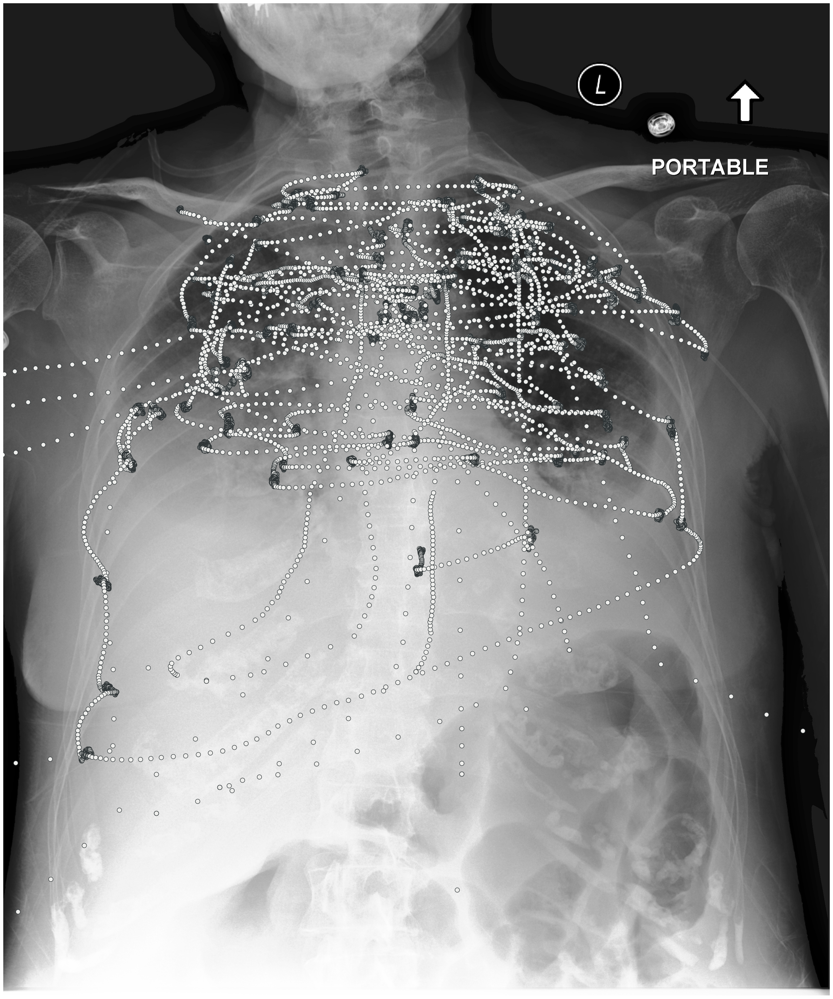

In [8]:
raw_fig = draw_raw(gaze_df['x_position'], gaze_df['y_position'], imagefile=image_path, markersize=10)

In [7]:
# prepare the fixation data
fix = get_fixations_dict_from_reflacx_eye_tracking(eye_tracking_df)

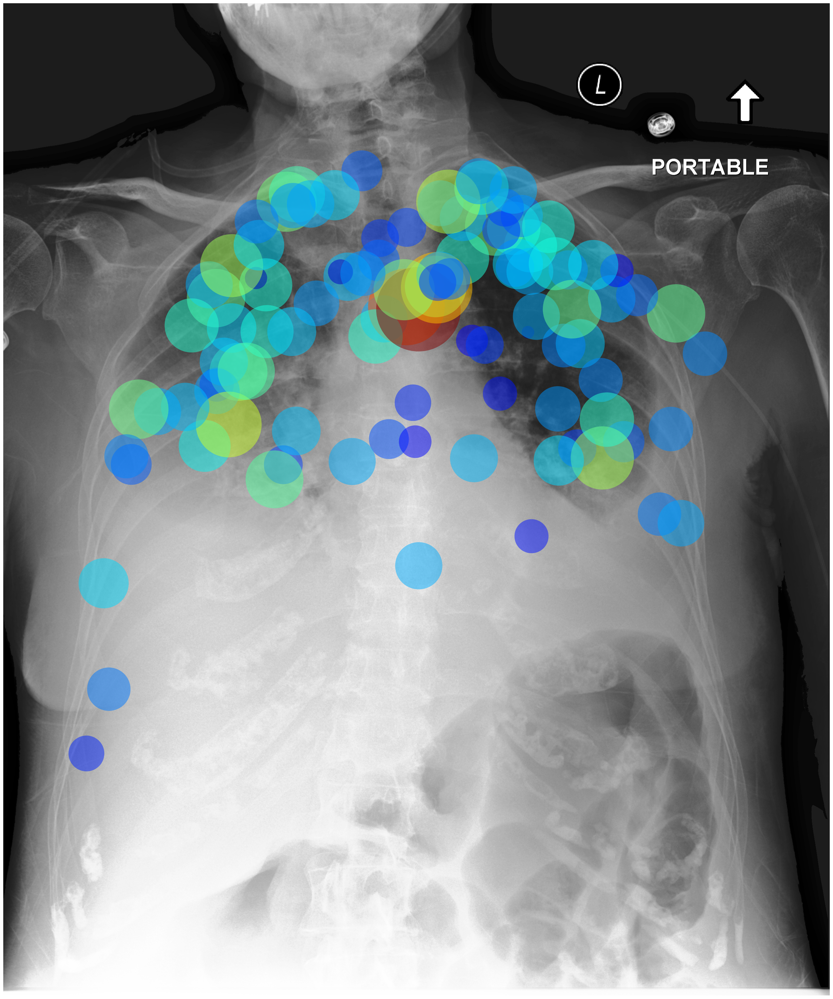

In [8]:
fixation_fig = draw_fixations(fix, imagefile=image_path)

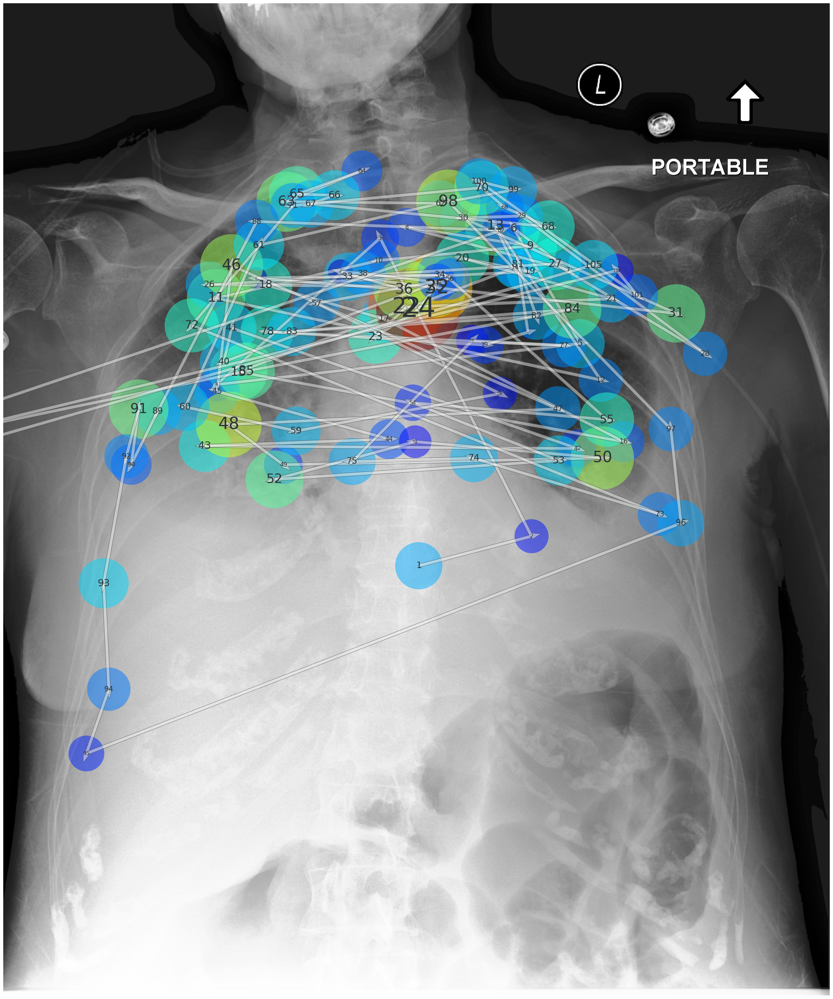

In [9]:
scanpath_fig = draw_scanpath(fix, imagefile= image_path)

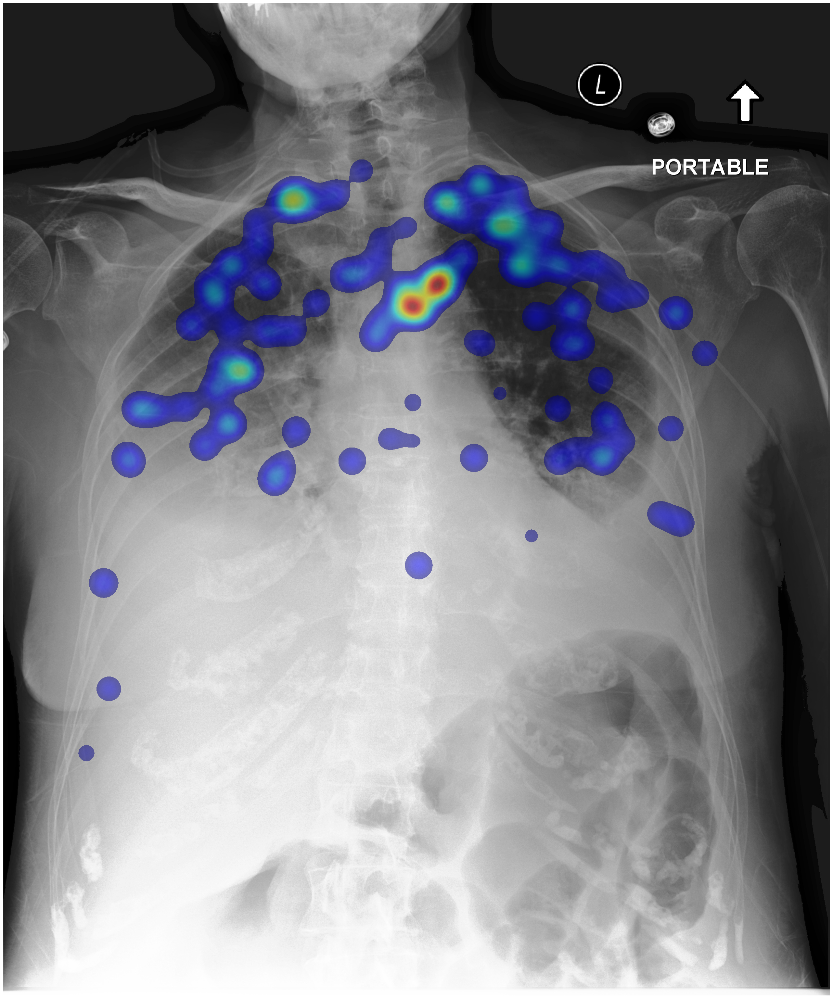

In [10]:
heatmap_fig = draw_heatmap(fix, imagefile=image_path)